In [1]:
%load_ext tensorboard

from bella.ciao import GemelEnv

import time
import os
import threading
import gym
import multiprocessing
import numpy as np
from queue import Queue
import argparse
import matplotlib.pyplot as plt
import enum
import random
import datetime
import tensorflow as tf

from collections import deque

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Conv2D, Conv1D, MaxPooling2D, AveragePooling2D, \
                         Flatten, Concatenate, Maximum, Average, Add, Lambda
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import Input, Model
from keras.callbacks import TensorBoard

from IPython.core.display import display, HTML, clear_output

# from https://pythonprogramming.net/deep-q-learning-dqn-reinforcement-learning-python-tutorial/

class ModifiedTensorBoard(TensorBoard):
    # Overriding init to set initial step and writer (we want one log file for all .fit() calls)
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.step = 1
        self.writer = tf.summary.FileWriter(self.log_dir)

    # Overriding this method to stop creating default log writer
    def set_model(self, model):
        pass

    # Overrided, saves logs with our step number
    # (otherwise every .fit() will start writing from 0th step)
    def on_epoch_end(self, epoch, logs=None):
        self.update_stats(**logs)

    # Overrided
    # We train for one batch only, no need to save anything at epoch end
    def on_batch_end(self, batch, logs=None):
        pass

    # Overrided, so won't close writer
    def on_train_end(self, _):
        pass

    # Custom method for saving own metrics
    # Creates writer, writes custom metrics and closes writer
    def update_stats(self, **stats):
        self._write_logs(stats, self.step)

def printProgressBar (iteration, total, prefix = '', suffix = '', decimals = 1, length = 100, fill = '█'):
    """
    Call in a loop to create terminal progress bar
    @params:
        iteration   - Required  : current iteration (Int)
        total       - Required  : total iterations (Int)
        prefix      - Optional  : prefix string (Str)
        suffix      - Optional  : suffix string (Str)
        decimals    - Optional  : positive number of decimals in percent complete (Int)
        length      - Optional  : character length of bar (Int)
        fill        - Optional  : bar fill character (Str)
    """
    percent = ("{0:." + str(decimals) + "f}").format(100 * (iteration / float(total)))
    filledLength = int(length * iteration // total)
    bar = fill * filledLength + '-' * (length - filledLength)
    print('\r%s |%s| %s%% %s' % (prefix, bar, percent, suffix), end = '\r')
    # Print New Line on Complete
    if iteration == total:
        print()

Using TensorFlow backend.


In [2]:
EPSILON = 0.1
EXPLORATION_DECAY = 0.99
GAMMA = 0.99

class DQNAgentExtended:

    class StateModel(enum.Enum):
        VN_ONLY = 1
        IDS = 2
        IDS_NONFLAT = 3

    def __init__(self, env, max_eps, period=10,
                 state_mode=StateModel.IDS, model=None,
                 gamma=GAMMA, max_epsilon=EPSILON,
                 epsilon_decay=EXPLORATION_DECAY, 
                 permutation_per_episode=False,
                 use_tensorboard=False,
                 use_experience_replay=False,
                 experience_maxlen=100,
                 experience_batchsize=5,
                 use_ddqn=True,
                 use_target_model=True,
                 target_update=10,
                 verbose=True,
                 simulate_toggle=True,
                 print_state=True,
                 print_loss=False):

        self.env = env
        self.max_episodes = max_eps
        self.epsilon = max_epsilon
        self.max_epsilon = max_epsilon
        self.epsilon_dacay = epsilon_decay
        self.period = period
        self.state_mode = state_mode
        self.gamma = gamma
        self.model = model(env)
        if use_target_model:
            self.target_model = model(env)
        else:
            self.target_model = self.model
        self.use_ddqn = use_ddqn
        self.permutation = list(range(len(env._hosts_sorted_by_id)))
        self.permutation_per_episode = permutation_per_episode
        self.logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
        self.use_tensorboard = use_tensorboard
        self.use_experience_replay = use_experience_replay
        self.experience = deque(maxlen=experience_maxlen)
        self.experience_batchsize = experience_batchsize
        self.target_update = target_update
        self.verbose = verbose
        self.simulate_toggle = simulate_toggle
        self.vnet_current = None
        self.print_state = print_state
        self.print_loss = print_loss
        
    def get_logdir(self):
        return self.logdir

    def _to_feature_vector(self, state):
        """Permutes the feature vector according to permutation"""        
        # converts from api to numpy array
        if self.state_mode == DQNAgentExtended.StateModel.VN_ONLY:
            return state[0][self.permutation]
        if self.state_mode == DQNAgentExtended.StateModel.IDS:
            return np.concatenate((state[0][self.permutation], state[1][self.permutation].flatten()))
        if self.state_mode == DQNAgentExtended.StateModel.IDS_NONFLAT:
            return (state[0][self.permutation], state[1][self.permutation])
        raise Exception(f"state model {self.state_mode} unknown")

    def train(self):

        tensorboard = ModifiedTensorBoard(log_dir=self.logdir)
        
        histories = []

        # train for max_eps episodes
        for episode in range(1, self.max_episodes + 1):
            if self.verbose:
                printProgressBar(episode, self.max_episodes)

            tensorboard.step = episode
            histories.append(self.train_one_episode())

        return histories
    
    def train_one_episode(self):
        # start at random position
        oldstate, terminal, step = self.env.reset(), False, 0

        self.vnet_current = oldstate[0]
        
        if self.permutation_per_episode:
            random.shuffle(self.permutation)
        time.sleep(self.period)

        state = self.state()

        # flatten state
        state = self._to_feature_vector(state)

        history = []

        # iterate step-by-step
        while not terminal:

            step += 1

            # pick action based on policy
            action, is_random = self.policy(state)
            if self.verbose:
                print()
                print(f"Taking action {action}")

            # run action and get reward
            state_next_raw, reward, terminal = self.step(action)

            # instead of using the immediate next state, wait for it to simmer
            if self.period > 0:
                time.sleep(self.period)
                state_next_raw = self.state()

            # flatten state
            state_next = self._to_feature_vector(state_next_raw)

            if self.verbose:
                if self.print_state:
                    print()
                    print(f"Step {step} reward={reward} new_state={state_next_raw}")
                else:
                    print()
                    print(f"Step {step} reward={reward} new_state={state_next_raw[0]}")

            # # this makes sense in an episodic environement
            # # where a terminal state means "losing"
            # if terminal:
            #    reward *= -1

            preds = self.unpermute(self.model.predict([[state_next]])) # unpermute next score prediction
            next_scores_prediction = preds[0]
            if self.verbose:
                print(f"Predicted scores for each action in next step: {next_scores_prediction}")


            # update model
            if self.use_experience_replay:
                self.experience.append({
                    "state": state, 
                    "action": action, 
                    "reward": reward,
                    "state_next": state_next,
                    "terminal": terminal
                })
            
                # train from samples in experience array
                self.fit_with_experience()
            else:
                # compute target Q
                q_target = ( reward + self.gamma * np.amax(next_scores_prediction) ) if not terminal else reward

                # update model
                q_updated = self.unpermute(self.model.predict([[state]]))[0]
                q_updated[action] = q_target
                training_verbosity = 0
                if self.print_loss:
                    training_verbosity = 2
                # q_updated is NOT permuted, we have to permute it again since state is still permuted
                q_updated = np.concatenate((q_updated[:-1][self.permutation], [q_updated[-1]]))
                self.model.fit([[state]], [[q_updated]], verbose=training_verbosity)

            # update weights after a while
            if step % self.target_update == 0:
                self.update_target_model()

            # update current state
            state = state_next

            # update history
            history.append({
                "time": step,
                "action": action,
                "reward": reward,
                "state": state_next_raw[0].tolist(),
                "random": is_random,
                "prediction": preds,
            })

        # apply exploration decay
        self.epsilon *= self.epsilon_dacay
        if self.verbose:
            print(f"Epsilon reduced to {self.epsilon}")

        return history
    
    def state(self):
        state = self.env.state()
        if not self.simulate_toggle:
            return self.env.state()
        return (self.vnet_current, self.env.state()[1])
    
    def step(self, action):
        if not self.simulate_toggle:
            return self.env.step(action)
        if action < len(self.vnet_current):
            self.vnet_current[action] = 1 - self.vnet_current[action]
        self.env.current_step += 1
        return (self.state(), self.env._get_placing_reward(self.vnet_current), self.env._is_terminal())
        
    
    def fit_with_experience(self):
        if len(self.experience) < self.experience_batchsize:
            return
        if self.verbose:
            print('fitting past experience')
        mini_batch = random.sample(self.experience, self.experience_batchsize)
        states = []
        qs_updated = []
        for i in range(self.experience_batchsize):
            state = mini_batch[i]["state"]
            state_next = mini_batch[i]["state_next"]
            reward = mini_batch[i]["reward"]
            action = mini_batch[i]["action"]
            terminal = mini_batch[i]["terminal"]
            
            current = self.unpermute(self.model.predict([[state]]))[0]
            current_next = self.unpermute(self.model.predict([[state_next]]))[0]
            
            if self.use_ddqn:
                # use current model to predict action and use target model to evaluate
                target_next = self.unpermute(self.target_model.predict([[state_next]]))[0]
                q_target = (reward  + self.gamma * target_next[np.argmax(current_next)]) if not terminal else reward
            elif self.use_target_model:
                # use target model to predict and evaluate next action
                target_next = self.unpermute(self.target_model.predict([[state_next]]))[0]
                q_target = (reward  + self.gamma * np.argmax(target_next)) if not terminal else reward
            else:
                # use current model to predict and evaluate next action
                q_target = (reward  + self.gamma * np.amax(current_next)) if not terminal else reward
            
            # use target model to estimate value
            q_updated = current
            q_updated[action] = q_target
            states.append(state)
            qs_updated.append(q_updated)
        training_verbosity = 0
        if self.print_loss:
            training_verbosity = 2
        if self.use_tensorboard:
            self.model.fit([states], [qs_updated], verbose=training_verbosity, batch_size=self.experience_batchsize,
                callbacks=[tensorboard] if terminal else None)
        else:
            self.model.fit([states], [qs_updated], verbose=training_verbosity, batch_size=self.experience_batchsize)

    
    def update_target_model(self):
        if self.verbose:
            print('updating target model weights')
        self.target_model.set_weights(self.model.get_weights())
    
    def unpermute(self, prediction):
        prediction = prediction[0]
        if self.env.actions == GemelEnv.ActionSpace.DOUBLE_BUTTON:
            # unpermute double button
            unpermuted = np.empty(prediction.size, prediction.dtype)
            for i, e in enumerate(self.permutation):
                unpermuted[2*e] = prediction[2*i]
                unpermuted[2*e+1] = prediction[2*i+1]
            unpermuted[-1] = prediction[-1]
            return np.array([unpermuted])
        
        # unpermute toggle
        return np.array([np.concatenate((prediction[np.argsort(self.permutation)], [prediction[-1]]))])

    def policy(self, state):
        if np.random.rand() < self.epsilon:
            if self.verbose:
                print("PERFORMING RANDOM ACTION")
            return np.random.randint(self.env.action_space.n), True
        else:
            expected_rewards = self.unpermute(self.model.predict([[state]]))[0]
            return np.argmax(expected_rewards), False

    def test(self):

        state, done = self.env.reset(), False
        self.vnet_current = state[0]
        total_reward = 0

        while not done:
            state = self._to_feature_vector(state)
            exp_rew = self.unpermute(self.model.predict([[state]]))[0]
            action = np.argmax(exp_rew)
            new_state, reward, done = self.step(action)
            total_reward += reward
            self.env.render()
            time.sleep(0.05)
            state = new_state

        # self.env.close()
        if self.verbose:
            print(f"Total reward: {total_reward}")
        return total_reward

In [3]:
class ModelAdapterDeepset:
    def __init__(self, model):
        self.model = model

    def fit(self, x, y, **kwargs):
        state = x[0][0]
        vns = state[0]
        obs = state[1]
        inputs = []
        for i in vns:
            inputs.append(np.expand_dims(i, axis=0))
        for i in obs:
            inputs.append(np.expand_dims(i, axis=0))
        for j in range(len(x[0])):
            if j == 0:
                continue
            state = x[0][j]
            vns = state[0]
            obs = state[1]
            for idx, i in enumerate(vns):
                inputs[idx] = np.concatenate((inputs[idx], np.expand_dims(i, axis=0)))
            idx_start = len(vns)
            for idx, i in enumerate(obs):
                inputs[idx+idx_start] = np.concatenate((inputs[idx+idx_start], np.expand_dims(i, axis=0)))
        return self.model.fit(inputs, y, **kwargs)
    
    def predict(self, x, **kwargs):
        state = x[0][0]
        vns = state[0]
        obs = state[1]
        inputs = []
        for i in vns:
            inputs.append(np.expand_dims(i, axis=0))
        for i in obs:
            inputs.append(np.expand_dims(i, axis=0))
        x = inputs
        return self.model.predict(x, **kwargs)
    
    def set_weights(self, *args, **kwargs):
        return self.model.set_weights(*args, **kwargs)
    
    def get_weights(self, *args, **kwargs):
        return self.model.get_weights(*args, **kwargs)

In [4]:
class ModelAdapter:
    def __init__(self, model):
        self.model = model

    def fit(self, x, y, **kwargs):
        state = x[0][0]
        vns = []
        obs = []
        for i in range(len(x[0])):
            state = x[0][i]
            vns.append(state[0])
            obs.append(state[1])
        x = {"vns": np.array(vns), "obs": np.array(obs)}
        return self.model.fit(x, y, **kwargs)
    
    def predict(self, x, **kwargs):
        state = x[0][0]
        vns = []
        obs = []
        for i in range(len(x[0])):
            state = x[0][i]
            vns.append(state[0])
            obs.append(state[1])
        x = {"vns": np.array(vns), "obs": np.array(obs)}
        return self.model.predict(x, **kwargs)
    
    def set_weights(self, *args, **kwargs):
        return self.model.set_weights(*args, **kwargs)
    
    def get_weights(self, *args, **kwargs):
        return self.model.get_weights(*args, **kwargs)

In [5]:
def model_permequi_simple(env, phi_dense1=4, phi_dense2=8, rho_dense=8, null_dense=8, pool_type='max', lr=0.01, verbose=True):
    pool_types = {
        'avg': Average(),
        'max': Maximum(),
        'sum': Add()
    }

    def gen_phi_model(name, latent_n1, latent_n2, vn_shape, obs_shape):
        shared_input_vn = Input(shape=vn_shape)
        shared_input_obs = Input(shape=obs_shape)
        if latent_n1 > 0:
            conv_obs = Dense(latent_n1, activation='relu')(shared_input_obs)
        else:
            conv_obs = shared_input_obs
        flatten_obs = Flatten()(conv_obs)
        concat_layer = Concatenate()([shared_input_vn, flatten_obs])
        if latent_n2 > 0:
            shared_dense = Dense(latent_n2, activation='relu', kernel_initializer='he_uniform')(concat_layer)
        else:
            shared_dense = concat_layer
        return Model(
            name=name,
            inputs=[shared_input_vn, shared_input_obs],
            outputs=[shared_dense],
        )
    
    def gen_rho_model(name, latent_n, batch_shape, vn_shape, obs_shape):
        shared_input_vn = Input(shape=vn_shape)
        shared_input_obs = Input(shape=obs_shape)
        shared_input_pool = Input(batch_shape=batch_shape)
        if latent_n > 0:
            conv_obs = Dense(latent_n, activation='relu')(shared_input_obs)
            flatten_obs = Flatten()(conv_obs)
        else:
            flatten_obs = Flatten()(shared_input_obs)
        concat_layer = Concatenate()([shared_input_vn, flatten_obs, shared_input_pool])
        shared_dense = Dense(1,)(concat_layer)
        return Model(
            name=name,
            inputs=[shared_input_vn, shared_input_obs, shared_input_pool],
            outputs=[shared_dense],
        )

    def gen_null_rho_model(name, latent_n, batch_shape, pool_type, num_inputs):
        phi_inputs = [Input(batch_shape=batch_shape) for i in range(num_inputs)]
        phis = phi_inputs
        # deepset for null output
        if latent_n > 0:
            dense_layer = Dense(latent_n, activation='relu',  kernel_initializer='he_uniform')
            phis = [dense_layer(phi) for phi in phis]
        pooled_layer = pool_types[pool_type](phis)
        output = Dense(1,)(pooled_layer)
        return Model(
            name=name,
            inputs=phi_inputs,
            outputs=[output],
        )
        
    vn_shape = (1,)
    obs_shape = (env.max_alerts_per_host, len(env.known_alerts))
    num_inputs = len(env._hosts_sorted_by_id)
    
    input_vns = [Input(shape=vn_shape) for i in range(num_inputs)]
    input_obs = [Input(shape=obs_shape) for i in range(num_inputs)]
    
    phi_model = gen_phi_model('phi', phi_dense1, phi_dense2, vn_shape, obs_shape)
    rho_model = gen_rho_model('rho', rho_dense, phi_model.output_shape, vn_shape, obs_shape)
    
    phis = [phi_model([input_vns[i], input_obs[i]]) for i in range(num_inputs)]

    # get pool stab(i) for each input
    # each input has an array of all phis except the phi with index matching the input
    # ref: https://arxiv.org/pdf/1903.01939.pdf
    # note: peer reviews have rejected this paper on grounds of novelty, but the result seems to be sound
    
    stab_i = []
    for i in range(num_inputs):
        pool_phi_in = [v for j, v in enumerate(phis) if j!=i]
        id_vn_in = input_vns[i]
        id_obs_in = input_obs[i]
        pooled_layer = pool_types[pool_type](pool_phi_in)
        stab_i.append(rho_model([id_vn_in, id_obs_in, pooled_layer]))

    null_action_model = gen_null_rho_model('null-rho', null_dense, phi_model.output_shape, pool_type, num_inputs)

    concat_layer = Concatenate()(stab_i + [null_action_model(phis)])
    
    model = Model(
        name='permutation-equivariant-model',
        inputs=input_vns + input_obs,
        outputs=[concat_layer],
    )
    model.compile(loss="mse", optimizer=Adam(lr=lr))
    
    if verbose:
        print('permequi-simple-model')
        model.summary()
    return ModelAdapterDeepset(model)

In [21]:
def model_permequi_simple_fixed(env, phi_dense1=4, phi_dense2=8, rho_dense=8, pool_type='max', lr=0.01, verbose=True):
    pool_types = {
        'avg': Average(name='pool'),
        'max': Maximum(name='pool'),
        'sum': Add(name='pool')
    }

    def gen_phi_model(name, latent_n1, latent_n2, vn_shape, obs_shape):
        shared_input_vn = Input(shape=vn_shape)
        shared_input_obs = Input(shape=obs_shape)
        if latent_n1 > 0:
            conv_obs = Dense(latent_n1, activation='relu')(shared_input_obs)
        else:
            conv_obs = shared_input_obs
        flatten_obs = Flatten()(conv_obs)
        concat_layer = Concatenate()([shared_input_vn, flatten_obs])
        if latent_n2 > 0:
            shared_dense = Dense(latent_n2, activation='relu', kernel_initializer='he_uniform')(concat_layer)
        else:
            shared_dense = concat_layer
        return Model(
            name=name,
            inputs=[shared_input_vn, shared_input_obs],
            outputs=[shared_dense],
        )
    
    def gen_rho_model(name, latent_n, batch_shape, vn_shape, obs_shape):
        shared_input_vn = Input(shape=vn_shape)
        shared_input_obs = Input(shape=obs_shape)
        shared_input_pool = Input(batch_shape=batch_shape)
        if latent_n > 0:
            conv_obs = Dense(latent_n, activation='relu')(shared_input_obs)
            flatten_obs = Flatten()(conv_obs)
        else:
            flatten_obs = Flatten()(shared_input_obs)
        concat_layer = Concatenate()([shared_input_vn, flatten_obs, shared_input_pool])
        shared_dense = Dense(1,)(concat_layer)
        return Model(
            name=name,
            inputs=[shared_input_vn, shared_input_obs, shared_input_pool],
            outputs=[shared_dense],
        )

    def gen_null_rho_model(name, batch_shape):
        pooled_input = Input(batch_shape=batch_shape)
        output = Dense(1,)(pooled_input)
        return Model(
            name=name,
            inputs=pooled_input,
            outputs=[output],
        )
        
    vn_shape = (1,)
    obs_shape = (env.max_alerts_per_host, len(env.known_alerts))
    num_inputs = len(env._hosts_sorted_by_id)
    
    input_vns = [Input(shape=vn_shape) for i in range(num_inputs)]
    input_obs = [Input(shape=obs_shape) for i in range(num_inputs)]
    
    phi_model = gen_phi_model('phi', phi_dense1, phi_dense2, vn_shape, obs_shape)
    rho_model = gen_rho_model('rho', rho_dense, phi_model.output_shape, vn_shape, obs_shape)
    
    phis = [phi_model([input_vns[i], input_obs[i]]) for i in range(num_inputs)]

    # get pool stab(i) for each input
    # each input has an array of all phis except the phi with index matching the input
    # ref: https://arxiv.org/pdf/1903.01939.pdf
    # note: peer reviews have rejected this paper on grounds of novelty, but the result seems to be sound
    
    stab_i = []
    for i in range(num_inputs):
        pool_phi_in = [v for j, v in enumerate(phis) if j!=i]
        id_vn_in = input_vns[i]
        id_obs_in = input_obs[i]
        pooled_layer = pool_types[pool_type](pool_phi_in)
        stab_i.append(rho_model([id_vn_in, id_obs_in, pooled_layer]))

    null_action_model = gen_null_rho_model('null-rho', phi_model.output_shape)
    null_pool = pool_types[pool_type](phis)

    concat_layer = Concatenate()(stab_i + [null_action_model(null_pool)])
    
    model = Model(
        name='permutation-equivariant-model',
        inputs=input_vns + input_obs,
        outputs=[concat_layer],
    )
    model.compile(loss="mse", optimizer=Adam(lr=lr))
    
    if verbose:
        print('permequi-simple-model')
        model.summary()
    return ModelAdapterDeepset(model)

In [7]:
def gen_model(model_func, **kwargs):
    def inner(env):
        return model_func(env, **kwargs)
    return inner

In [8]:
env = GemelEnv(interval=20, max_alerts=10, max_steps=100, use_counts_by_time=True, agg_interval=5)
env.reset()

agent = DQNAgentExtended(env, period=1, gamma=0.5, max_epsilon=0.1, epsilon_decay=0.95, max_eps=65, state_mode=DQNAgentExtended.StateModel.IDS_NONFLAT, 
                 model=gen_model(model_permequi_simple, phi_dense1=12, phi_dense2=16, null_dense=0, rho_dense=8, pool_type='max', lr=0.01, verbose=True), 
                 use_experience_replay=False, target_update=10000, permutation_per_episode=True, verbose=True, simulate_toggle=True, print_loss=True, print_state=True)

W0218 14:44:48.907960 140692748420864 deprecation.py:506] From /root/jupenv/lib/python3.7/site-packages/tensorflow_core/python/ops/resource_variable_ops.py:1630: calling BaseResourceVariable.__init__ (from tensorflow.python.ops.resource_variable_ops) with constraint is deprecated and will be removed in a future version.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


permequi-simple-model
Model: "permutation-equivariant-model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_7 (InputLayer)            [(None, 10, 2)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 10, 2)]      0                                            
________________________________________________

permequi-simple-model
Model: "permutation-equivariant-model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_24 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_30 (InputLayer)           [(None, 10, 2)]      0                                            
__________________________________________________________________________________________________
input_25 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_31 (InputLayer)           [(None, 10, 2)]      0                                            
________________________________________________

In [9]:
hist = agent.train()

 |█---------------------------------------------------------------------------------------------------| 1.5% 
Taking action 6

Step 1 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [

W0218 14:44:58.087020 140692748420864 deprecation.py:323] From /root/jupenv/lib/python3.7/site-packages/tensorflow_core/python/ops/math_grad.py:1424: where (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 1 samples
1/1 - 1s - loss: 0.6334

Taking action 4

Step 2 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1


Taking action 4

Step 9 reward=-3 new_state=(array([1, 0, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 16 reward=-4 new_state=(array([1, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 23 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 30 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    

PERFORMING RANDOM ACTION

Taking action 1

Step 37 reward=-3 new_state=(array([1, 0, 1, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5,


Taking action 3

Step 44 reward=-4 new_state=(array([1, 1, 1, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 2

Step 51 reward=-5 new_state=(array([1, 1, 0, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 58 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 65 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 5

Step 72 reward=-5 new_state=(array([1, 1, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
    


Taking action 4

Step 79 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
    


Taking action 0

Step 86 reward=-4 new_state=(array([0, 1, 1, 1, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 93 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 6

Step 100 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
   


Taking action 6

Step 7 reward=-3 new_state=(array([1, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 2

Step 14 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 1

Step 21 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 2

Step 28 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 35 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0,


Taking action 5

Step 42 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 5

Step 49 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 5

Step 56 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 1

Step 63 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 70 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 77 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 3

Step 84 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 3

Step 91 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 0

Step 98 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 5 reward=-5 new_state=(array([1, 1, 1, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 1

Step 12 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 19 reward=-5 new_state=(array([0, 1, 1, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3,


Taking action 0

Step 26 reward=-4 new_state=(array([0, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 33 reward=-3 new_state=(array([0, 0, 1, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1,


Taking action 2

Step 40 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 3

Step 47 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 3

Step 54 reward=-2 new_state=(array([1, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 4

Step 61 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2,


Taking action 2

Step 68 reward=-4 new_state=(array([0, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 75 reward=-4 new_state=(array([1, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
    


Taking action 2

Step 82 reward=-5 new_state=(array([1, 1, 0, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 6

Step 89 reward=-4 new_state=(array([1, 1, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 96 reward=-4 new_state=(array([1, 1, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 3 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 10 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 17 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 24 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 31 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 6

Step 38 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 45 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 59 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 66 reward=-2 new_state=(array([1, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 73 reward=-3 new_state=(array([1, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 80 reward=-3 new_state=(array([1, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 87 reward=-2 new_state=(array([1, 1, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 1

Step 94 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    

Epsilon reduced to 0.08145062499999998
 |███████---------------------------------------------------------------------------------------------| 7.7% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
   


Taking action 0

Step 8 reward=-2 new_state=(array([1, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 1

Step 15 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 3

Step 22 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 2

Step 29 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 0

Step 36 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
    


Taking action 3

Step 43 reward=-2 new_state=(array([1, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 1

Step 50 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 1

Step 57 reward=-2 new_state=(array([1, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3,


Taking action 0

Step 64 reward=-2 new_state=(array([0, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 71 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 1

Step 78 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 3

Step 85 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 4

Step 92 reward=-4 new_state=(array([1, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 0

Step 99 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 6 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
     


Taking action 3

Step 13 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 2

Step 20 reward=-2 new_state=(array([0, 0, 0, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 2

Step 27 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
    


Taking action 2

Step 34 reward=-2 new_state=(array([0, 0, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
    


Taking action 2

Step 41 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 2

Step 48 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 2

Step 55 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 0

Step 62 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 1

Step 69 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
     


Taking action 4

Step 83 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 90 reward=-2 new_state=(array([1, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2,


Taking action 3

Step 97 reward=-2 new_state=(array([0, 0, 0, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 2

Step 11 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 5

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 4

Step 25 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 4

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 39 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 5

Step 53 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 5

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 67 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 4

Step 81 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 4

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 95 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 0],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 2

Step 9 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 5

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 0

Step 23 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 30 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 37 reward=-2 new_state=(array([1, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
    


Taking action 4

Step 44 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 2

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     

PERFORMING RANDOM ACTION

Taking action 0

Step 58 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3,


Taking action 1

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 5

Step 72 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
    


Taking action 5

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 5

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 5

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 5

Step 100 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
   


Taking action 2

Step 7 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 5

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 5

Step 21 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 5

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 5

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
    


Taking action 2

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
        [3, 4],
     

PERFORMING RANDOM ACTION

Taking action 2

Step 49 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2,


Taking action 5

Step 56 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 3

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
     


Taking action 3

Step 70 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
    


Taking action 5

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     

PERFORMING RANDOM ACTION

Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 

PERFORMING RANDOM ACTION

Taking action 5

Step 91 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4,


Taking action 4

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 5 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
     


Taking action 2

Step 19 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 0

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 4

Step 33 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
    


Taking action 1

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 3

Step 47 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 5

Step 61 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 5

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 5

Step 75 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0,


Taking action 3

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 2

Step 89 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 4

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 5

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 5

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 5

Step 17 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
    


Taking action 0

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 3

Step 31 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 1

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 45 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
    


Taking action 4

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 4

Step 59 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 4

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
     


Taking action 2

Step 73 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 5

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 2

Step 87 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 1

Step 94 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
    

Epsilon reduced to 0.05688000922764597
 |██████████████████----------------------------------------------------------------------------------| 18.5% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
  


Taking action 3

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
      


Taking action 2

Step 15 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 4

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 4

Step 29 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
    


Taking action 4

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 4

Step 43 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 4

Step 57 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
    


Taking action 2

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 2

Step 71 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 4

Step 78 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
    


Taking action 1

Step 85 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
    


Taking action 4

Step 92 reward=-4 new_state=(array([1, 0, 1, 1, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 99 reward=-3 new_state=(array([0, 0, 1, 1, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 2

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
      


Taking action 3

Step 13 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 2

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 3

Step 27 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
    


Taking action 1

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 3

Step 41 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 4

Step 48 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 3

Step 55 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 5

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 0

Step 69 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
    


Taking action 3

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 2

Step 83 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 97 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 4

Step 11 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
    


Taking action 2

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 2

Step 25 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
    


Taking action 5

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 5

Step 39 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 46 reward=-2 new_state=(array([0, 0, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0,


Taking action 5

Step 53 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 3

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 0

Step 67 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 4

Step 81 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 4

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 4

Step 95 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
    


Taking action 3

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 5

Step 9 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 2

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 2

Step 23 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 5

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 5

Step 37 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 5

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 4

Step 51 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 0

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 0

Step 65 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 4

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 4

Step 79 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
     


Taking action 3

Step 93 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 4

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 2

Step 7 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 2

Step 14 reward=-2 new_state=(array([0, 0, 1, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1,


Taking action 5

Step 21 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 5

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 4

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 2

Step 49 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 

PERFORMING RANDOM ACTION

Taking action 4

Step 63 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1,


Taking action 3

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 0

Step 77 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 2

Step 84 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 5

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 3

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     

PERFORMING RANDOM ACTION

Taking action 0

Step 5 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 


Taking action 5

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 19 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 26 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 6

Step 33 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 40 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 6

Step 47 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 6

Step 54 reward=-4 new_state=(array([1, 1, 1, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 6

Step 61 reward=-4 new_state=(array([1, 0, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 68 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 2

Step 75 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 2

Step 82 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 2

Step 89 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 2

Step 96 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 2

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 3

Step 17 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 3

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 5

Step 31 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 5

Step 38 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 3

Step 52 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
    


Taking action 0

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 2

Step 66 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 5

Step 80 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 5

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 94 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    

Epsilon reduced to 0.039721431845821824
 |█████████████████████████████-----------------------------------------------------------------------| 29.2% 
Taking action 0

Step 1 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
 


Taking action 2

Step 8 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 1

Step 15 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 1

Step 22 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 0

Step 29 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 0

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 2

Step 43 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 2

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 92 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 3

Step 99 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 0

Step 6 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 13 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 20 reward=-2 new_state=(array([1, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0,


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 41 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 6

Step 48 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 55 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 6

Step 62 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 6

Step 69 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 5

Step 76 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
    


Taking action 4

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 4

Step 90 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 4

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 3

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 4

Step 11 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1,


Taking action 3

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 2

Step 25 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 5

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 4

Step 39 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
    


Taking action 4

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 5

Step 53 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 4

Step 67 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 4

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 81 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 3

Step 95 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 5

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
      


Taking action 4

Step 9 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 2

Step 23 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 2

Step 37 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 3

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 4

Step 51 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 3

Step 65 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 4

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 79 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 


Taking action 4

Step 93 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 4

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 7 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 4

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 4

Step 21 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
    


Taking action 0

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 4

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 4

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 0

Step 49 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
    


Taking action 4

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 0

Step 63 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 4

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 3

Step 77 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 3

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 4

Step 91 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 1

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 3

Step 5 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 3

Step 12 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 19 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 0

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 2

Step 33 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
    


Taking action 3

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 4

Step 47 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 4

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 4

Step 61 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
    


Taking action 4

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 2

Step 75 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 82 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 89 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 3

Step 96 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 24 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
    

PERFORMING RANDOM ACTION

Taking action 1

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     

Epsilon reduced to 0.027738957312183378
 |████████████████████████████████████████------------------------------------------------------------| 40.0% 
Taking action 6

Step 1 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
 


Taking action 6

Step 8 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 15 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 6

Step 22 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 0

Step 29 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
    


Taking action 0

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 0

Step 43 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 0

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 0

Step 57 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
    


Taking action 0

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 0

Step 71 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 78 reward=-2 new_state=(array([1, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2,


Taking action 0

Step 85 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
    


Taking action 5

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 4

Step 99 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 0

Step 6 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 0

Step 13 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 6

Step 20 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 0],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0,


Taking action 0

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 0

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 11 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 6

Step 18 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 25 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 32 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 4

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 46 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 4

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 5

Step 2 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
      

PERFORMING RANDOM ACTION

Taking action 1

Step 16 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0,


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 0

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 5

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 4

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 5

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     

Epsilon reduced to 0.019371148445850084
 |██████████████████████████████████████████████████--------------------------------------------------| 50.8% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 2],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 5

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 3

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
      

PERFORMING RANDOM ACTION

Taking action 4

Step 12 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1,


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     

Epsilon reduced to 0.01352759542790559
 |█████████████████████████████████████████████████████████████---------------------------------------| 61.5% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
  


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     

PERFORMING RANDOM ACTION

Taking action 2

Step 17 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0,


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     

Epsilon reduced to 0.00944682441377376
 |████████████████████████████████████████████████████████████████████████----------------------------| 72.3% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
  


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 0],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 0

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 1],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     

Epsilon reduced to 0.006597069817787189
 |███████████████████████████████████████████████████████████████████████████████████-----------------| 83.1% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
      

PERFORMING RANDOM ACTION

Taking action 4

Step 13 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0,


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 0],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [5, 5],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 3

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 3],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 3],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 1],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 5 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 5

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 4

Step 26 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 4

Step 33 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 54 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 4

Step 61 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
     

Epsilon reduced to 0.004606979898695193
 |█████████████████████████████████████████████████████████████████████████████████████████████-------| 93.8% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 4

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 5

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 1],
        [3, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     

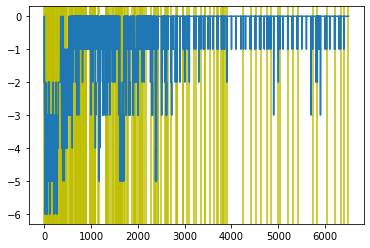

In [10]:
flat_hist = [x for h in hist for x in h]
ticks = [idx for idx, x in enumerate(flat_hist) if x["random"]]
for xc in ticks: plt.axvline(x=xc, color='y')
plt.plot([x['reward'] for x in flat_hist])

In [11]:
agent.test()

Total reward: -1


-1

In [12]:
agent.state()

(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
         [0, 1],
         [0, 1],
         [0, 2],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 0]],
 
        [[0, 0],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 2]],
 
        [[0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 2],
         [0, 0],
         [0, 1]],
 
        [[0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 2],
         [0, 0]],
 
        [[3, 3],
         [0, 0],
         [2, 2],
         [3, 3],
         [0, 0],
         [2, 2],
         [3, 4],
         [0, 0],
         [1, 2],
         [4, 4]],
 
        [[3, 3],
         [0, 0],
         [2, 3],
         [3, 3],
         [0, 0],
         [2, 2],
      

In [13]:
env = GemelEnv(interval=20, max_alerts=10, max_steps=100, use_counts_by_time=True, agg_interval=5)
env.reset()

agent = DQNAgentExtended(env, period=1, gamma=0.5, max_epsilon=0.1, epsilon_decay=0.95, max_eps=65, state_mode=DQNAgentExtended.StateModel.IDS_NONFLAT, 
                 model=gen_model(model_permequi_simple_fixed, phi_dense1=12, phi_dense2=16, rho_dense=8, pool_type='max', lr=0.01, verbose=True), 
                 use_experience_replay=False, target_update=10000, permutation_per_episode=True, verbose=True, simulate_toggle=True, print_loss=True, print_state=True)

permequi-simple-model
Model: "permutation-equivariant-model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_170 (InputLayer)          [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_176 (InputLayer)          [(None, 10, 2)]      0                                            
__________________________________________________________________________________________________
input_171 (InputLayer)          [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_177 (InputLayer)          [(None, 10, 2)]      0                                            
________________________________________________

permequi-simple-model
Model: "permutation-equivariant-model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_188 (InputLayer)          [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_194 (InputLayer)          [(None, 10, 2)]      0                                            
__________________________________________________________________________________________________
input_189 (InputLayer)          [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_195 (InputLayer)          [(None, 10, 2)]      0                                            
________________________________________________

In [14]:
hist = agent.train()

 |█---------------------------------------------------------------------------------------------------| 1.5% 
Taking action 3

Step 1 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [


Taking action 2

Step 8 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 3

Step 15 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 0

Step 22 reward=-5 new_state=(array([0, 1, 1, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 29 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 3

Step 36 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 3

Step 43 reward=-4 new_state=(array([1, 1, 1, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 3

Step 50 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 57 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 3

Step 64 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 1

Step 71 reward=-4 new_state=(array([1, 0, 1, 1, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 78 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 1

Step 85 reward=-4 new_state=(array([1, 0, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 3

Step 92 reward=-3 new_state=(array([1, 1, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 3

Step 99 reward=-3 new_state=(array([1, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 3

Step 6 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
     


Taking action 2

Step 13 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 3

Step 20 reward=-4 new_state=(array([1, 1, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
    


Taking action 1

Step 27 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
    


Taking action 0

Step 34 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 0

Step 41 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 6

Step 48 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 6

Step 55 reward=-5 new_state=(array([0, 1, 1, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0,

PERFORMING RANDOM ACTION

Taking action 3

Step 62 reward=-6 new_state=(array([1, 1, 1, 1, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5,


Taking action 3

Step 69 reward=-5 new_state=(array([1, 1, 1, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 0

Step 76 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 3

Step 83 reward=-4 new_state=(array([1, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 1

Step 90 reward=-5 new_state=(array([1, 1, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 0

Step 97 reward=-4 new_state=(array([0, 0, 1, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 3

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 2

Step 11 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 2

Step 18 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 0

Step 25 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 0

Step 32 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 39 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5,


Taking action 2

Step 46 reward=-2 new_state=(array([0, 0, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
    


Taking action 2

Step 53 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
    


Taking action 2

Step 60 reward=-4 new_state=(array([0, 1, 0, 1, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 2

Step 67 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 0

Step 74 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 0

Step 81 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 88 reward=-4 new_state=(array([1, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4,


Taking action 1

Step 95 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 3

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 3

Step 9 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     

PERFORMING RANDOM ACTION

Taking action 0

Step 16 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3,


Taking action 5

Step 23 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 1

Step 30 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
    


Taking action 0

Step 37 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 0

Step 44 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 51 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 6

Step 58 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 6

Step 65 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 72 reward=-2 new_state=(array([0, 0, 1, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0,


Taking action 6

Step 79 reward=-2 new_state=(array([0, 0, 1, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 6

Step 86 reward=-3 new_state=(array([0, 0, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 93 reward=-3 new_state=(array([0, 0, 1, 1, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0,


Taking action 0

Step 100 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
   

PERFORMING RANDOM ACTION

Taking action 2

Step 7 reward=-3 new_state=(array([0, 1, 1, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 


Taking action 1

Step 14 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 3

Step 21 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
    


Taking action 2

Step 28 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
    


Taking action 2

Step 35 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 1

Step 42 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 4

Step 49 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 2

Step 56 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 1

Step 63 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
    


Taking action 0

Step 70 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 1

Step 77 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 3

Step 84 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 91 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0,


Taking action 0

Step 98 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 5

Step 5 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 0

Step 12 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 1

Step 19 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 2

Step 26 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 33 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 5

Step 40 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 4

Step 47 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 54 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
    


Taking action 6

Step 61 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 68 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 4

Step 75 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 4

Step 82 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
    


Taking action 6

Step 89 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 96 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    

PERFORMING RANDOM ACTION

Taking action 6

Step 3 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 


Taking action 4

Step 10 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 4

Step 17 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 5

Step 24 reward=-4 new_state=(array([1, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 31 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 4

Step 38 reward=-2 new_state=(array([0, 0, 1, 0, 1, 0]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 45 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 52 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 59 reward=-2 new_state=(array([0, 0, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 5

Step 66 reward=-2 new_state=(array([0, 0, 1, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
    


Taking action 3

Step 73 reward=-3 new_state=(array([0, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
    


Taking action 6

Step 80 reward=-3 new_state=(array([0, 1, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
    


Taking action 6

Step 87 reward=-3 new_state=(array([0, 1, 1, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 94 reward=-3 new_state=(array([0, 1, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
    

Epsilon reduced to 0.06983372960937498
 |████████████----------------------------------------------------------------------------------------| 12.3% 
Taking action 2

Step 1 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
  


Taking action 5

Step 8 reward=-2 new_state=(array([0, 0, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 4

Step 15 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
    


Taking action 4

Step 22 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 5

Step 29 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 4

Step 36 reward=-4 new_state=(array([0, 1, 1, 1, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 5

Step 43 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 5

Step 50 reward=-4 new_state=(array([0, 1, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 5

Step 57 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 64 reward=-4 new_state=(array([0, 1, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 4

Step 71 reward=-3 new_state=(array([0, 1, 0, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 5

Step 78 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
    


Taking action 5

Step 85 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 92 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 4

Step 99 reward=-3 new_state=(array([1, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 4

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
      


Taking action 4

Step 13 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 4

Step 20 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 27 reward=-3 new_state=(array([1, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0,


Taking action 4

Step 34 reward=-2 new_state=(array([1, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 4

Step 41 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 4

Step 48 reward=-4 new_state=(array([1, 1, 0, 1, 0, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 55 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0,


Taking action 6

Step 62 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 69 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 76 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 6

Step 83 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 6

Step 90 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 97 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 11 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 6

Step 18 reward=-4 new_state=(array([1, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 2

Step 25 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 1

Step 32 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 39 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
    


Taking action 1

Step 46 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 1

Step 53 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 1

Step 60 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 1

Step 67 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 1

Step 74 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 2

Step 81 reward=-2 new_state=(array([1, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 88 reward=-3 new_state=(array([1, 1, 0, 1, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 1

Step 95 reward=-2 new_state=(array([0, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 2

Step 9 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 3

Step 16 reward=-4 new_state=(array([0, 0, 1, 1, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 2

Step 23 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
    


Taking action 2

Step 30 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
    


Taking action 1

Step 37 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 44 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 6

Step 51 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 6

Step 58 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 65 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 72 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 6

Step 79 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 2

Step 86 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 1

Step 93 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 100 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
   


Taking action 1

Step 7 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 14 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 21 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 6

Step 28 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
    


Taking action 6

Step 42 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 6

Step 49 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 1

Step 56 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0,


Taking action 6

Step 63 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
    


Taking action 6

Step 70 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 77 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 84 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 91 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0,


Taking action 5

Step 98 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 5

Step 5 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 5

Step 12 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 4

Step 19 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 5

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 5

Step 33 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 5

Step 47 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 5

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 


Taking action 4

Step 61 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 4

Step 75 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 5

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 5

Step 89 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 4

Step 96 reward=-2 new_state=(array([0, 1, 0, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 4

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 5

Step 17 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 5

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 5

Step 31 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 4

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 4

Step 45 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
    


Taking action 4

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 4

Step 59 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 4

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 4

Step 73 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 80 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 5

Step 87 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 4

Step 94 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    

Epsilon reduced to 0.04876749791155295
 |███████████████████████-----------------------------------------------------------------------------| 23.1% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
  


Taking action 4

Step 8 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
     


Taking action 5

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 5

Step 22 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
    


Taking action 5

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 5

Step 36 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 5

Step 43 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 50 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
    


Taking action 4

Step 57 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 4

Step 64 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 5

Step 71 reward=-4 new_state=(array([0, 1, 1, 1, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 5

Step 78 reward=-3 new_state=(array([0, 1, 1, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 85 reward=-2 new_state=(array([0, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 4

Step 92 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 5

Step 99 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 5

Step 13 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 20 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
    


Taking action 5

Step 27 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 4

Step 34 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 4

Step 41 reward=-3 new_state=(array([0, 1, 1, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 5

Step 48 reward=-4 new_state=(array([0, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 55 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 62 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 69 reward=-2 new_state=(array([0, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 6

Step 76 reward=-2 new_state=(array([0, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 83 reward=-3 new_state=(array([0, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 6

Step 90 reward=-2 new_state=(array([0, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 6

Step 97 reward=-2 new_state=(array([0, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 5

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 25 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 6

Step 32 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 39 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 6

Step 46 reward=-2 new_state=(array([0, 1, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 53 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 60 reward=-2 new_state=(array([0, 1, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 4

Step 67 reward=-5 new_state=(array([1, 1, 1, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 74 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 81 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 88 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 95 reward=-3 new_state=(array([1, 1, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 9 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 16 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 23 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
    


Taking action 6

Step 30 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 6

Step 37 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 44 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 6

Step 51 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 58 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 65 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 72 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    

PERFORMING RANDOM ACTION

Taking action 0

Step 79 reward=-3 new_state=(array([0, 0, 0, 1, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0,


Taking action 6

Step 86 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 6

Step 7 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 14 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 5

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 28 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 6

Step 35 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
    


Taking action 6

Step 42 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 6

Step 49 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 56 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
    


Taking action 6

Step 63 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 70 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 77 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 5 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 19 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 26 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 75 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 6

Step 82 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 89 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 6

Step 96 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 3 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 24 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
    


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 45 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 52 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 59 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 6

Step 66 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 73 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0,


Taking action 1

Step 80 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
    


Taking action 5

Step 87 reward=-5 new_state=(array([1, 1, 1, 1, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 5

Step 94 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
    

Epsilon reduced to 0.03405616262881148
 |█████████████████████████████████-------------------------------------------------------------------| 33.8% 
Taking action 6

Step 1 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
  


Taking action 6

Step 8 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 15 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 6

Step 22 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
    


Taking action 6

Step 29 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 6

Step 36 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 6

Step 43 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
    


Taking action 6

Step 50 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 6

Step 57 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 6

Step 64 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 71 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
    


Taking action 6

Step 78 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
    


Taking action 6

Step 85 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
    


Taking action 6

Step 92 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 6

Step 99 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 6

Step 6 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 13 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
    


Taking action 6

Step 20 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 6

Step 27 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 6

Step 34 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
    


Taking action 6

Step 41 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
    


Taking action 4

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 4 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 11 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 6

Step 18 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 3

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 2

Step 32 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 1

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 0

Step 46 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
    


Taking action 6

Step 53 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 3

Step 60 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 1

Step 67 reward=-3 new_state=(array([1, 0, 1, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 1

Step 74 reward=-4 new_state=(array([1, 1, 1, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
    


Taking action 0

Step 81 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 3

Step 88 reward=-2 new_state=(array([0, 0, 0, 1, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 2

Step 95 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
    


Taking action 0

Step 2 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 1

Step 9 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 


Taking action 0

Step 16 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
    


Taking action 4

Step 23 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 1

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 5

Step 37 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 4

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 5

Step 51 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
    


Taking action 5

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 2

Step 65 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 3

Step 72 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 2

Step 79 reward=-3 new_state=(array([0, 0, 1, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 0

Step 86 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 2

Step 93 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 3

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 1

Step 7 reward=-3 new_state=(array([0, 1, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 0

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 2

Step 21 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 4

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 5

Step 49 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 4

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 5

Step 70 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 5

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 4

Step 84 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    

PERFORMING RANDOM ACTION

Taking action 2

Step 91 reward=-2 new_state=(array([0, 1, 1, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2,


Taking action 0

Step 98 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 4

Step 5 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     

PERFORMING RANDOM ACTION

Taking action 1

Step 12 reward=-2 new_state=(array([0, 1, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0,


Taking action 4

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 5

Step 26 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 0

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 3

Step 40 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 4

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 4

Step 54 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 1

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 0

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 4

Step 75 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 4

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 1

Step 89 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 4

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 4

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 4

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 17 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 2

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 1

Step 31 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
    


Taking action 0

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 4

Step 45 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 2

Step 52 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 5

Step 66 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 0

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 4

Step 80 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
    


Taking action 4

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 5

Step 94 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
    

Epsilon reduced to 0.023782688525533217
 |████████████████████████████████████████████--------------------------------------------------------| 44.6% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
 


Taking action 2

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
      


Taking action 4

Step 15 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
    


Taking action 4

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 3

Step 29 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 3

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 3

Step 43 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 4

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 3

Step 57 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 3

Step 71 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 4

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 85 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 3

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 2

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 4

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
      


Taking action 4

Step 13 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
    


Taking action 0

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 27 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 2

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 4

Step 41 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 4

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 3

Step 55 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0,


Taking action 2

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 4

Step 69 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 4

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 3

Step 83 reward=-1 new_state=(array([0, 0, 0, 1, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
    


Taking action 0

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 0

Step 97 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 4

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
      


Taking action 4

Step 11 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 0

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 25 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
    


Taking action 4

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 4

Step 39 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 3

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 1

Step 53 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 1

Step 67 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
    


Taking action 0

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 4

Step 81 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
    


Taking action 0

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 0

Step 95 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
    


Taking action 5

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
      


Taking action 4

Step 9 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 0

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 23 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
    


Taking action 4

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 0

Step 37 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
    


Taking action 4

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 0

Step 51 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 5

Step 65 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 0

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 79 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 5

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 1

Step 93 reward=-1 new_state=(array([0, 1, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 0

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
    


Taking action 0

Step 7 reward=-3 new_state=(array([1, 0, 0, 0, 0, 0]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 2

Step 14 reward=-2 new_state=(array([0, 0, 0, 0, 0, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 21 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 4

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 5

Step 35 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
    


Taking action 5

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 0

Step 49 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 5

Step 63 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
    


Taking action 5

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 0

Step 77 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
    


Taking action 5

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 0

Step 91 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 0

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 0

Step 5 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 4

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 5

Step 19 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
    


Taking action 4

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 4

Step 33 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 4

Step 47 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 0

Step 61 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
    


Taking action 4

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 75 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
    


Taking action 0

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 4

Step 89 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
    


Taking action 0

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 4

Step 3 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 0

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
     


Taking action 4

Step 17 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
    


Taking action 0

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 0

Step 31 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
    


Taking action 4

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 0

Step 45 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
    


Taking action 4

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 59 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
    


Taking action 4

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 0

Step 73 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
    


Taking action 4

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 0

Step 87 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    

PERFORMING RANDOM ACTION

Taking action 6

Step 94 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0,

Epsilon reduced to 0.016608338398760712
 |███████████████████████████████████████████████████████---------------------------------------------| 55.4% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
 


Taking action 0

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
      


Taking action 4

Step 15 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
    


Taking action 0

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 4

Step 29 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
    


Taking action 0

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 4

Step 43 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
    


Taking action 0

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 4

Step 57 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 0

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 0

Step 71 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 0

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 0

Step 85 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 4

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 0

Step 99 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
    


Taking action 0

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
      


Taking action 0

Step 13 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
    


Taking action 4

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 0

Step 27 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
    


Taking action 4

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 0

Step 41 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
    


Taking action 0

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 4

Step 55 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
    


Taking action 0

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 4

Step 69 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 4

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
     


Taking action 0

Step 83 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
    


Taking action 4

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 0

Step 97 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
    


Taking action 0

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
      


Taking action 4

Step 11 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
    


Taking action 0

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 0

Step 25 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
    


Taking action 4

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 0

Step 39 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
    


Taking action 4

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 0

Step 53 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
    


Taking action 4

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 0

Step 67 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
    


Taking action 4

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 0

Step 81 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
    


Taking action 4

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 4

Step 95 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
    


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
      


Taking action 0

Step 9 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 4

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 0

Step 23 reward=-1 new_state=(array([1, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
    


Taking action 4

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 0

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 2

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     

Epsilon reduced to 0.011598222130000552
 |██████████████████████████████████████████████████████████████████----------------------------------| 66.2% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 3]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1]],

       [[0, 0],
        [1, 0],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 1],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[5, 4],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     

PERFORMING RANDOM ACTION

Taking action 2

Step 94 reward=-1 new_state=(array([0, 0, 1, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4,

Epsilon reduced to 0.008099471081759275
 |████████████████████████████████████████████████████████████████████████████------------------------| 76.9% 
Taking action 5

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 0, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 1],
        [3, 4],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 0],
        [0, 0],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 2],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [3, 4],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 4],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 79 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 2],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 3],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 1],
        [3, 3]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 3],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 2],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     

Epsilon reduced to 0.005656162735025291
 |███████████████████████████████████████████████████████████████████████████████████████-------------| 87.7% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
 


Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
     


Taking action 2

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 0

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 4],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 2],
        [2, 3],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 0],
        [4, 5],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 4 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
      


Taking action 6

Step 11 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 18 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 25 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 32 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 39 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 46 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 53 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 60 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 67 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 74 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 81 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 2],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 88 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 95 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 4

Step 2 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
      


Taking action 6

Step 9 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
      


Taking action 6

Step 16 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 23 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 30 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
     


Taking action 6

Step 37 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 44 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 51 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 58 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 65 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 72 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     

PERFORMING RANDOM ACTION

Taking action 5

Step 79 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0,


Taking action 6

Step 86 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 93 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
     


Taking action 6

Step 100 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
    


Taking action 6

Step 7 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
      


Taking action 6

Step 14 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
     


Taking action 6

Step 21 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 28 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4]],

       [[2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
     


Taking action 6

Step 35 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 42 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 49 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 56 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
     


Taking action 6

Step 63 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
     


Taking action 6

Step 70 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 77 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 84 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 91 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
     


Taking action 6

Step 98 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 5 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
      


Taking action 6

Step 12 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0]],

       [[0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
     


Taking action 6

Step 19 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 26 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 33 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 40 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 47 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 54 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 61 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4]],

       [[1, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
     


Taking action 6

Step 68 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 75 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 82 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 89 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
     


Taking action 6

Step 96 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 3 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
      


Taking action 6

Step 10 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
     


Taking action 6

Step 17 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 24 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 31 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 38 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 45 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
     


Taking action 6

Step 52 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 59 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 66 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 73 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 80 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3]],

       [[5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
     


Taking action 6

Step 87 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4]],

       [[2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
     


Taking action 6

Step 94 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1]],

       [[0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
     

Epsilon reduced to 0.0039499093906437905
 |██████████████████████████████████████████████████████████████████████████████████████████████████--| 98.5% 
Taking action 4

Step 1 reward=-1 new_state=(array([0, 0, 0, 0, 1, 0]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],



Taking action 6

Step 8 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 0],
        [5, 5],
        [0, 0],
        [0, 1],
      


Taking action 6

Step 15 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3]],

       [[4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 3],
     


Taking action 6

Step 22 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5]],

       [[2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
     


Taking action 6

Step 29 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1]],

       [[0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
     


Taking action 6

Step 36 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
     


Taking action 6

Step 43 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2]],

       [[4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 50 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 1],
        [5, 5]],

       [[3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
     


Taking action 6

Step 57 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
     


Taking action 6

Step 64 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0]],

       [[0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
     


Taking action 6

Step 71 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0]],

       [[2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
     


Taking action 6

Step 78 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
     


Taking action 6

Step 85 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[1, 2],
        [0, 0],
        [4, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
     


Taking action 6

Step 92 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0]],

       [[0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
     


Taking action 6

Step 99 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 4],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 6 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0]],

       [[1, 1],
        [4, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0]],

       [[1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
      


Taking action 6

Step 13 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 2]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4]],

       [[5, 5],
        [0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
     


Taking action 6

Step 20 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [2, 3],
        [3, 3]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
     


Taking action 6

Step 27 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0]],

       [[0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
     


Taking action 6

Step 34 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [5, 5],
        [0, 1],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0]],

       [[1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
     


Taking action 6

Step 41 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[3, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3]],

       [[4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
     


Taking action 6

Step 48 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[4, 4],
        [0, 0],
        [1, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1],
        [5, 5]],

       [[3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [2, 2],
        [4, 4],
     


Taking action 6

Step 55 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 0],
        [5, 5],
        [1, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 2]],

       [[0, 0],
        [0, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 1],
     


Taking action 6

Step 62 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 69 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0]],

       [[3, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 3],
        [0, 0],
        [2, 2],
        [4, 4],
        [0, 0],
        [1, 2]],

       [[3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0],
        [2, 3],
     


Taking action 6

Step 76 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2]],

       [[4, 5],
        [0, 0],
        [1, 1],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5],
        [0, 0],
        [0, 0],
        [5, 5]],

       [[4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [5, 5],
     


Taking action 6

Step 83 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 2],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0]],

       [[1, 1],
        [0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [4, 4],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 2]],

       [[0, 1],
        [0, 0],
        [4, 5],
        [1, 1],
        [0, 0],
        [4, 4],
        [1, 1],
     


Taking action 6

Step 90 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
        [0, 2],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0]],

       [[0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 0],
        [3, 3],
        [2, 2],
        [0, 0],
        [3, 3],
        [2, 3],
        [0, 0],
        [3, 3],
        [3, 3],
        [0, 0]],

       [[0, 0],
        [4, 4],
        [1, 2],
        [0, 0],
        [3, 4],
        [2, 2],
        [0, 0],
     


Taking action 6

Step 97 reward=0 new_state=(array([0, 0, 0, 0, 1, 1]), array([[[0, 1],
        [0, 1],
        [0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[0, 0],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 1],
        [0, 0],
        [0, 1]],

       [[0, 1],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 0],
        [0, 1],
        [0, 2],
        [0, 0],
        [0, 1],
        [0, 0]],

       [[2, 2],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 4],
        [0, 0],
        [1, 1],
        [4, 5],
        [0, 0],
        [1, 1]],

       [[2, 3],
        [3, 3],
        [0, 0],
        [2, 2],
        [3, 4],
        [0, 0],
        [1, 2],
     

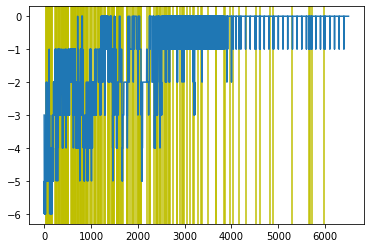

In [15]:
flat_hist = [x for h in hist for x in h]
ticks = [idx for idx, x in enumerate(flat_hist) if x["random"]]
for xc in ticks: plt.axvline(x=xc, color='y')
plt.plot([x['reward'] for x in flat_hist])

In [16]:
agent.test()

Total reward: -1


-1

In [17]:
agent.state()

(array([0, 0, 0, 0, 1, 1]), array([[[0, 0],
         [0, 2],
         [0, 2],
         [0, 0],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1]],
 
        [[0, 1],
         [0, 0],
         [0, 2],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 0],
         [0, 1]],
 
        [[0, 1],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 0],
         [0, 1],
         [0, 2],
         [0, 0]],
 
        [[0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 2],
         [0, 0],
         [0, 1],
         [0, 1],
         [0, 0],
         [0, 1]],
 
        [[3, 3],
         [2, 3],
         [0, 0],
         [2, 2],
         [3, 3],
         [0, 0],
         [2, 2],
         [3, 3],
         [0, 0],
         [2, 2]],
 
        [[3, 4],
         [2, 2],
         [0, 0],
         [3, 3],
         [2, 3],
         [0, 0],
      